# 3. Обработка пленоптических фотографий

Данное задание состоит двух основных частей. **Оно не является конкурсным**, за каждое подзадание можно получить максимальное качество баллов за приемлемую работу. Интересные мысли и красивая реализация приветствуются.

## Часть 1. Lytro Light Field Camera (8 баллов)

![plenoptic_small.jpg](plenoptic_small.jpg)

В 2011 году появилась камера Lytro Light Field Camera. Вот краткое описание формата пикселей:
* Базовое разрешение 3280x3280
* Линзы в массиве упакованы "как соты" (поэтому каждый второй ряд на полпикселя сдвинут относительно другого)
* Под каждой линзой количество пикселей по высоте и ширине не является целым
* Более того, этот массив микролинз немного повёрнут относительно массива пикселей

В этой части задания мы попробуем руками получить хоть что-то красивое из сырых изображений, а также научимся сдвигать наблюдателя в плоскости объектива

**Для начала откроем изображение**

In [1]:
import skimage.io
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import HTML
from IPython.display import Image as ImageDisplay
from tqdm import tqdm_notebook 
import imageio
image = skimage.io.imread('bee.png')
image = image / image.max()

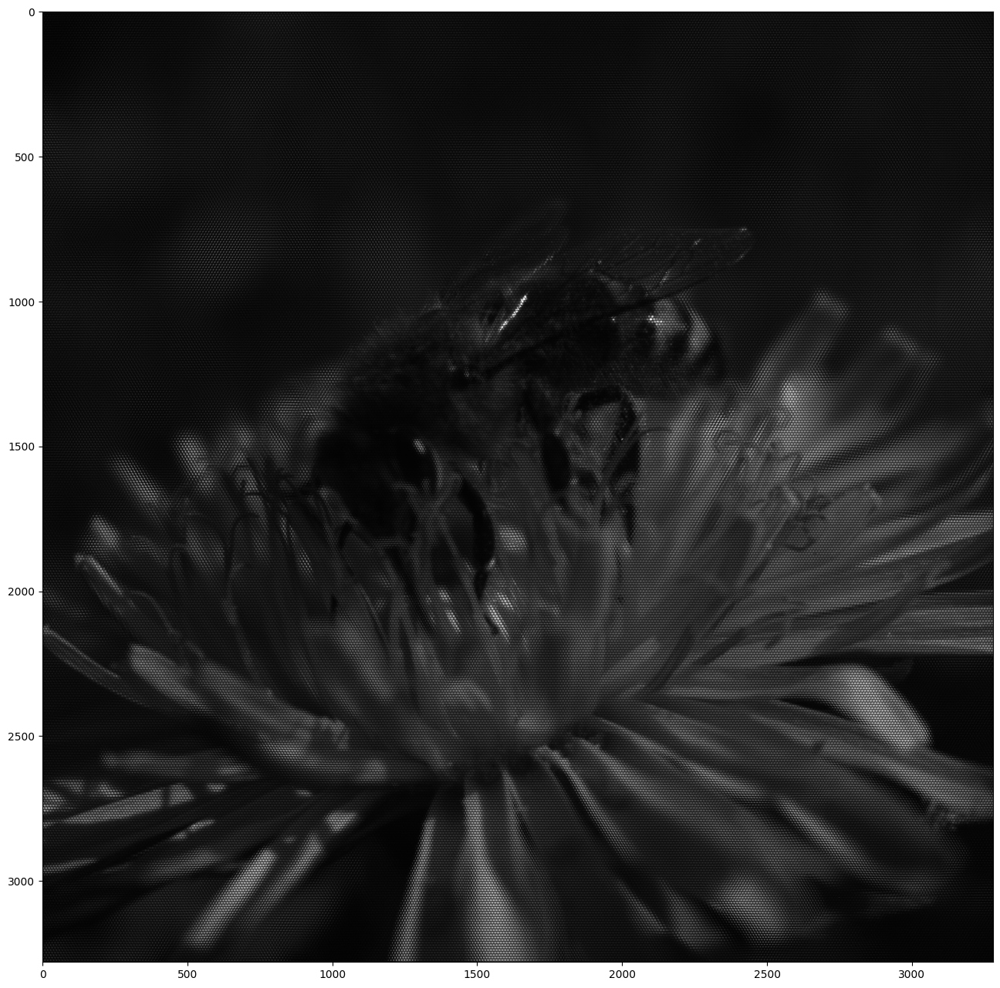

In [2]:
image_array = np.array(image)
plt.figure(figsize=(16, 16))
plt.imshow(image_array, cmap='gray')
plt.show()

Увеличим его часть:

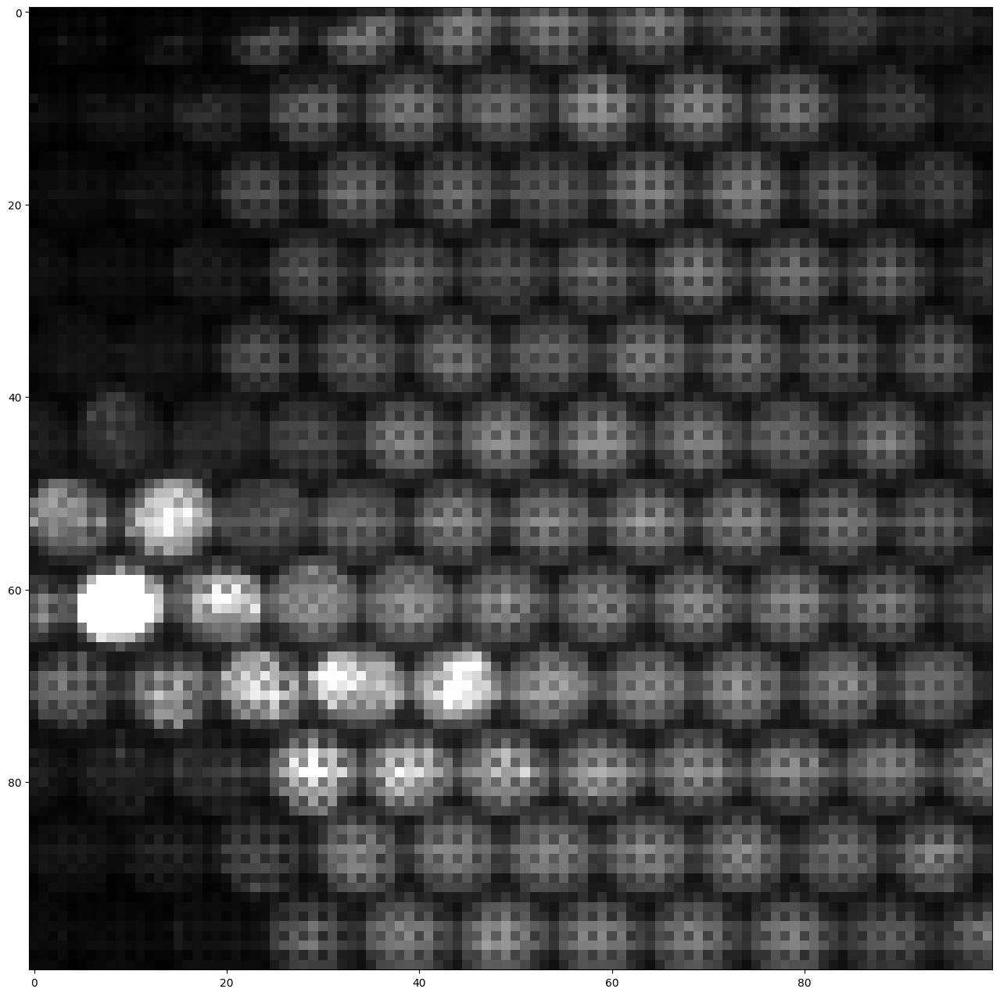

In [3]:
image_array = np.array(image)
plt.figure(figsize=(16, 16))
plt.imshow(image_array[1000:1100, 2090:2190], cmap='gray')
plt.show()

Чётко прослеживается структура массива линз, кроме того, видим, что и внутри линз есть своя структура - некоторые пиксели регулярно темнее/светлее остальных. Дело в том, что изначально каждый фотодиод фотоматрицы принимает только определённый цвет изображения, так как [накрыт цветным фильтром](https://ru.wikipedia.org/wiki/%D0%A4%D0%B8%D0%BB%D1%8C%D1%82%D1%80_%D0%91%D0%B0%D0%B9%D0%B5%D1%80%D0%B0).

Преобразуем сырые данные камеры в RGB-изображение. Для этого:
* Составим маску красных, синих и зелёных каналов на сыром изображении
* Произведём интерполяцию путём усреднения соседних известных значений канала

Первый шаг - составление маски. Начиная с левого верхнего угла, цвет хранится так:
<table><tr><td bgcolor="#0000FF"></td><td bgcolor="#00FF00"></td></tr><tr><td bgcolor="#00FF00"></td><td bgcolor="#FF0000"></td></tr></table>
Напишите функцию, которая по заданной высоте и ширине изображения составит маски каналов (4 матрицы, значение элемента внутри которых равно единице в пикселях, который содержит B, G1, G2 или R компоненту соответственно).
Например, для изображения $2x2$ матрица для цветовой компоненты B выглядит так:
$$ \quad
\begin{pmatrix}
1 & 0 \\
0 & 0
\end{pmatrix}
\quad $$

Обратите внимание, что G-канал разделён на два для последующего удобства обработки.

In [5]:
# Подзказка: объявите массивы-маски 2x2 и затем используйте np.tile
# В Lytro формат цвета такой
# B G1
# G2 R
def get_bayer_pattern_masks(h, w):
    '''
    Возвращает 4 маски заданной высоты и ширины для сырого изображения формата
    B G1
    G2 R
    :param h: int, height of bayer pattern
    :param w: int, width of bayer pattern
    :return [numpy.ndarray((h, w)), numpy.ndarray((h, w)), numpy.ndarray((h, w)), numpy.ndarray((h, w))]
    маски для B-компоненты, G1-компоненты, G2-компоненты и R-компоненты
    '''
    b = np.array([[1, 0],
                [0, 0]])
    g1 = np.array([[0, 1],
                [0, 0]])
    g2 = np.array([[0, 0],
                [1, 0]])
    r = np.array([[0, 0],
                [0, 1]])
    B = np.tile(b, (h // 2, w // 2))
    G1 = np.tile(g1, (h // 2, w // 2))
    G2 = np.tile(g2, (h // 2, w // 2))
    R = np.tile(r, (h // 2, w // 2))

    return [B, G1, G2, R]

Следующий шаг - интерполяция каналов. Действовать будем по [этой статье](https://www.researchgate.net/profile/Henrique-Malvar/publication/4087683_High-quality_linear_interpolation_for_demosaicing_of_Bayer-patterned_color_images/links/0fcfd50d1e1b44b180000000/High-quality-linear-interpolation-for-demosaicing-of-Bayer-patterned-color-images.pdf). Суть её заключается в том, что для каждого из четырёх типов пикселей мы вычисляем веса неизвестных каналов следующим способом:

![bayer_interpolation.png](bayer_interpolation.png)

In [50]:
def high_quality_bayer_interpolation(raw_image):
    h = raw_image.shape[0]
    w = raw_image.shape[1]
    
    weigths_0 = (1 / 8) * np.array([
        [ 0,  0, 1/2,  0,  0],
        [ 0, -1,   0, -1,  0],
        [-1,  4,   5,  4, -1],
        [ 0, -1,   0, -1,  0],
        [ 0,  0, 1/2,  0,  0]
    ])

    weigths_1 = (1 / 8) * np.array([
        [  0,  0,  -1,  0,   0],
        [  0, -1,   4, -1,   0],
        [1/2,  0,   5,  0, 1/2],
        [  0, -1,   4, -1,   0],
        [  0,  0,  -1,  0,   0]
    ])

    weigths_2 = (1 / 8) * np.array([
        [   0,  0, -3/2,  0,    0],
        [   0,  2,    0,  2,    0],
        [-3/2,  0,    6,  0, -3/2],
        [   0,  2,    0,  2,    0],
        [   0,  0, -3/2,  0,    0]
    ])

    weigths_3 = (1 / 8) * np.array([
        [ 0,  0, -1,  0,  0],
        [ 0,  0,  2,  0,  0],
        [-1,  2,  4,  2, -1],
        [ 0,  0,  2,  0,  0],
        [ 0,  0, -1,  0,  0]
    ])

    image = np.zeros((h, w, 3), dtype=np.float)
    mask_b, mask_g1, mask_g2, mask_r = get_bayer_pattern_masks(h, w)

    raw_image = np.pad(raw_image, ((2, 2), (2, 2)), constant_values=((0, 0),(0, 0)))
    for i in range(h):
        for j in range(w):
            if mask_r[i][j]:
                image[i, j, 0] = raw_image[i + 2, j + 2]
                image[i, j, 1] = np.sum(raw_image[i:i+5, j:j+5]*weigths_3)
                image[i, j, 2] = np.sum(raw_image[i:i+5, j:j+5]*weigths_2)
            elif mask_b[i][j]:
                image[i, j, 0] = np.sum(raw_image[i:i+5, j:j+5]*weigths_2)
                image[i, j, 1] = np.sum(raw_image[i:i+5, j:j+5]*weigths_3)
                image[i, j, 2] = raw_image[i + 2, j + 2]
            elif mask_g1[i][j]:
                image[i, j, 0] = np.sum(raw_image[i:i+5, j:j+5]*weigths_1)
                image[i, j, 1] = raw_image[i + 2, j + 2]
                image[i, j, 2] = np.sum(raw_image[i:i+5, j:j+5]*weigths_0)
            elif mask_g2[i][j]:
                image[i, j, 0] = np.sum(raw_image[i:i+5, j:j+5]*weigths_0)
                image[i, j, 1] = raw_image[i + 2, j + 2]
                image[i, j, 2] = np.sum(raw_image[i:i+5, j:j+5]*weigths_1)


    return np.clip(image, 0, 1)

In [51]:
image_interpolated = high_quality_bayer_interpolation(image_array)

C:\Users\doodo\AppData\Local\Temp\ipykernel_12080\2173108114.py:37: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  image = np.zeros((h, w, 3), dtype=np.float)


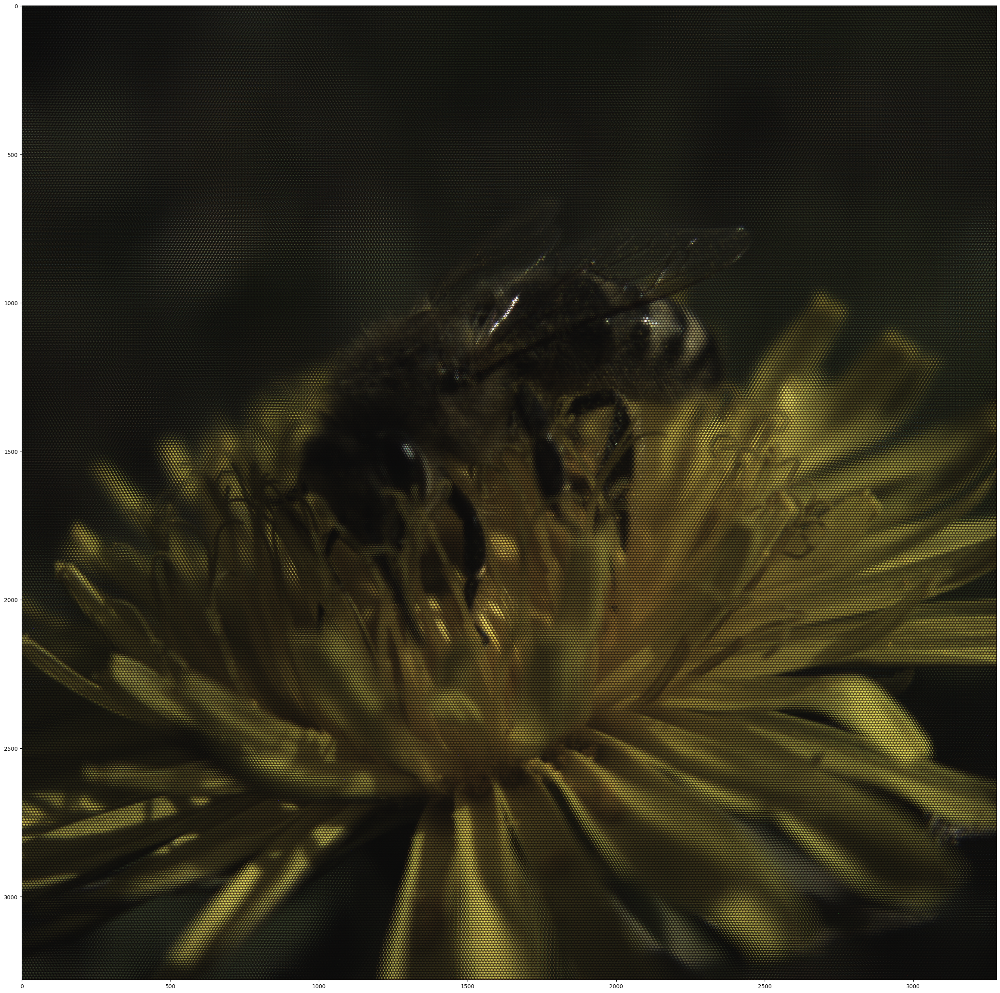

In [52]:
plt.figure(figsize=(32, 32))
plt.imshow(image_interpolated)
plt.show()

In [66]:
skimage.io.imsave("b.png", image_interpolated)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


**Ура!** Теперь осталось его правильно обработать. Давайте реализуем сдвиг по вертикали и горизонтали.

В простейшем случае процесс описан в [этой ссылке](http://www.plenoptic.info/pages/sub-aperture.html) (только параграф про получение Sub-apertures!). По сути, нужно выбрать пиксели внутри каждого блока с некоторым сдвигом

In [185]:

def baseline_move(plenoptic_raw_image, plenoptic_image_config, position_shift_y, position_shift_x):
    raw_image_height = plenoptic_raw_image.shape[0]
    raw_image_width = plenoptic_raw_image.shape[1]
    block_height = plenoptic_image_config['block_height']
    block_width = plenoptic_image_config['block_width']
    block_count_h = int(raw_image_height // block_height)
    block_count_w = int(raw_image_width // block_width)
    result = np.zeros((block_count_h, block_count_w, 3))
    
    # Учтите, что высота линзы и её ширина не равна целому числу пикселей 
    # поэтому не пренебрегайте использования магическими константами 
    # (block_height - высота линзы, block_width - её ширина). 
    # Также учтите, что каждый второй ряд сдвинут относительно первого.
    # Замечание: написать вложенные циклы тут ОК
    second_row_shift = 3
    first_row_shift = 8
    second_col_shift = block_height / 2
    first_col_shift = block_height / 2
    for i in range(block_count_h):
        for j in range(block_count_w):
            if i % 2:
                result[i, j, :] = plenoptic_raw_image[int(i * block_height + second_col_shift + position_shift_y),
                                                   int(j * block_width + position_shift_x + second_row_shift), :]
            else:
                result[i, j, :] = plenoptic_raw_image[int(i * block_height + first_col_shift + position_shift_y),
                                                   int(j * block_width + position_shift_x + first_row_shift), :]
    return result

In [ ]:
plenoptic_image_config = {
    'block_width': 9.927582228653469,
    'block_height': 8.607538408172838
}

In [ ]:
images = []
for dx in tqdm_notebook(range(0, 1, 1)):
    for dy in range(0, 1, 1):
        image = baseline_move(image_interpolated, plenoptic_image_config, dy, dx)
        images.append(image)

In [78]:
output_file='baseline_move.gif'
import imageio
duration = 1
imageio.mimsave(output_file, images, duration=duration)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


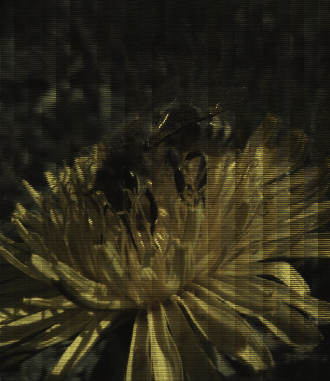

In [79]:
with open('baseline_move.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='png'))

x*Что ожидается увидеть: заметное движение заднего фона, однако, яркость изображений будет отличаться, это нормально. Кроме того, возможны небольшие горизонтальные/вертикальные полоски.*.

Несоответствие по яркости происходит из-за того, что через массив микролинз свет падает неравномерно на массив фотодиодов, а при дебайеринге мы никак не учитывали этот факт.
Попробуем отнормировать изображения по цвету. Для этого воспользуйтесь функцией [match_histograms](http://scikit-image.org/docs/dev/auto_examples/transform/plot_histogram_matching.html)


In [188]:
images = []

# YOUR CODE
#image = baseline_move(image_interpolated, plenoptic_image_config, 0, 0)
#h, w, _ = image.shape
#reference = np.clip(image[h//3:2*h//3, w//3:2*w//3] * 1.2, 0, 1)
for dx in tqdm_notebook(range(-3, 4, 1)):
    for dy in range(-3, 4, 1):
        image = baseline_move(image_interpolated, plenoptic_image_config, dy, dx)
        h, w, _ = image.shape
        k = 3
        for i in range(k**2):
            if np.sum(np.histogram(image[i // k: i // k + 1, i % k: i % k + 1])[0][7:10]) > np.sum(np.histogram(reference)[0][7:10]):
                reference = np.clip(image[i // k: i // k + 1, i % k: i % k + 1], 0, 1)
        # YOUR CODE
        image = skimage.exposure.match_histograms(image, reference, channel_axis=-1)

        images.append(image)
    for image in images[-1:-8:-1]:
        images.append(image)

C:\Users\doodo\AppData\Local\Temp\ipykernel_12080\3968837192.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dx in tqdm_notebook(range(-3, 4, 1)):


  0%|          | 0/7 [00:00<?, ?it/s]

In [190]:
output_file='baseline_move_with_histograms.gif'
fps = 10
imageio.mimsave(output_file, images, fps=fps)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

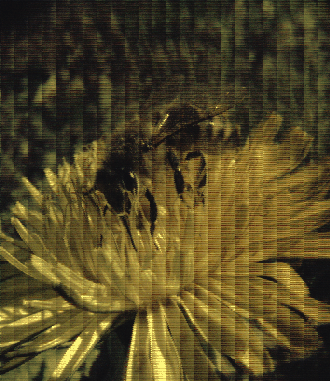

In [171]:
with open('baseline_move_with_histograms.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

## Часть 2. Немного 3D (7 баллов)

В этом подзадании требуется получить [анаглифное](https://ru.wikipedia.org/wiki/%D0%90%D0%BD%D0%B0%D0%B3%D0%BB%D0%B8%D1%84) изображение на основе полученных данных. План приблизительно следующий:
* Создайте два изображения с максимальным параллаксом (горизонтальным расстоянием между виртуальными камерами)
* Наложите их друг на друга, используя цветовые фильтры
* Получите ещё больше баллов за небольшой анализ (пробуйте уменьшать/увеличивать параллакс, создаёте gif-картинку). Что будет, если изначально накладывать изображения с небольшим сдвигом?

In [247]:
images = []
images_ex = []
images_diff = []
image = baseline_move(image_interpolated, plenoptic_image_config, 0, 0)
h, w, _ = image.shape
reference = image[h//3:2*h//3, w//3:2*w//3]
for i in range(4):
    left = baseline_move(image_interpolated, plenoptic_image_config, 0, -i)
    right  = baseline_move(image_interpolated, plenoptic_image_config, 0, i)

    left = skimage.exposure.match_histograms(left, reference, channel_axis=-1)
    right = skimage.exposure.match_histograms(right, reference, channel_axis=-1)
    k = 2
    for i in range(k**2):
        left[i // k: (i + 1) // k, i % k: (i + 1) % k] = skimage.exposure.match_histograms(left[i // k: (i + 1) // k, i % k: (i + 1) % k], reference, channel_axis=-1)
        right[i // k: (i + 1) // k, i % k: (i + 1) % k] = skimage.exposure.match_histograms(right[i // k: (i + 1) // k, i % k: (i + 1) % k], reference, channel_axis=-1)
    # Optimized anaglyph from https://sview.ru/ru/help/devices/anaglyph/ (https://research.csc.ncsu.edu/stereographics/LS.pdf)
    res = np.zeros((h, w, 3), dtype=np.float64)
    res[:, :, 0] = 0.4154 * left[:, :, 0] + 0.4710 * left[:, :, 1] + 0.1669 * left[:, :, 2] - 0.0109 * right[:, :, 0] - 0.0364 * right[:, :, 1] - 0.0060 * right[:, :, 2]
    res[:, :, 1] = -0.0458 * left[:, :, 0] - 0.0484 * left[:, :, 1] - 0.0257 * left[:, :, 2] + 0.3756 * right[:, :, 0] + 0.7333 * right[:, :, 1] + 0.0111 * right[:, :, 2]
    res[:, :, 2] = -0.0547 * left[:, :, 0] - 0.0615 * left[:, :, 1] + 0.0128 * left[:, :, 2] - 0.0651 * right[:, :, 0] -0.1287 * right[:, :, 1] + 1.2971 * right[:, :, 2]
    images_ex.append(np.clip(res, 0, 1))
    res = np.zeros((h, w, 3), dtype=np.float64)

    res[:, :, 0] = left[:, :, 0]
    res[:, :, 1] = right[:, :, 1]
    res[:, :, 2] = right[:, :, 2]

    images.append(res)
    res = np.zeros((h, w, 3), dtype=np.float64)
    diff = 8
    res[:, :- diff, 0] = left[:, diff:, 0]
    res[:, :- diff, 1] = right[:, :- diff, 1]
    res[:, :- diff, 2] = right[:, :- diff, 2]

    images_diff.append(res[:, :- diff])

In [248]:
output_file='agl.gif'
fps = 3
imageio.mimsave(output_file, images, fps=fps)
skimage.io.imsave("agl.png", images[3])
output_file='agl_ex.gif'
fps = 3
imageio.mimsave(output_file, images_ex, fps=fps)
skimage.io.imsave("agl_ex.png", images_ex[3])
output_file='agl_diff.gif'
fps = 3
imageio.mimsave(output_file, images_diff, fps=fps)
skimage.io.imsave("agl_diff.png", images_diff[3])

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

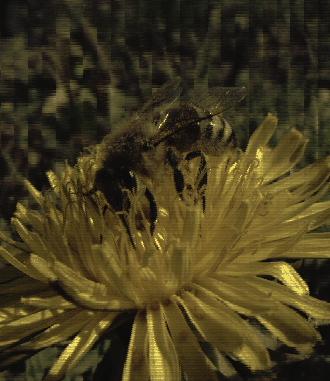

In [249]:
with open('agl.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

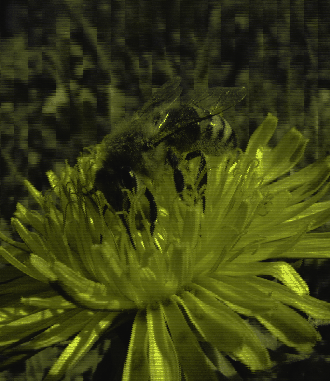

In [250]:
with open('agl_ex.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

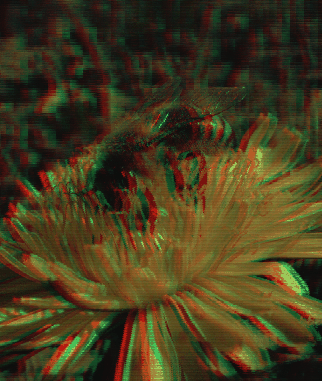

In [251]:
with open('agl_diff.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

Text(0.5, 1.0, 'Red-cyan anaglyph with diff')

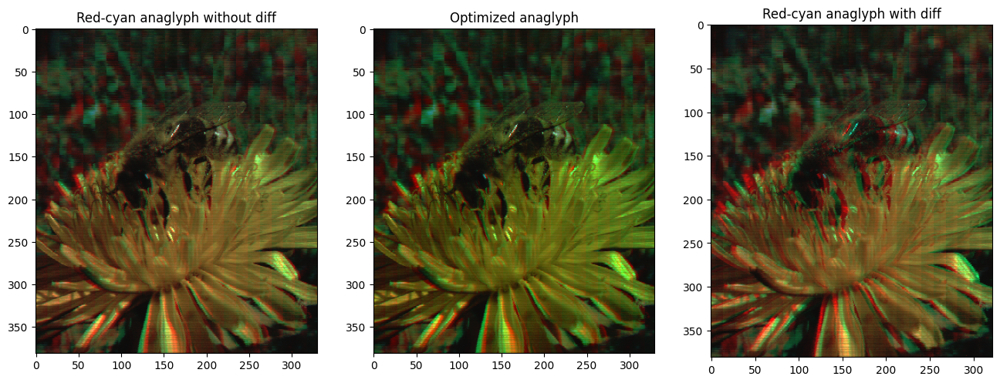

In [252]:
plt.figure(figsize=(16, 32))
plt.subplot(1, 3, 1)
plt.imshow(images[3])
plt.title('Red-cyan anaglyph without diff')
plt.subplot(1, 3, 2)
plt.imshow(images_ex[3])
plt.title('Optimized anaglyph')
plt.subplot(1, 3, 3)
plt.imshow(images_diff[3])
plt.title('Red-cyan anaglyph with diff')

## The end?

![dear_princess_celestia.jpg](dear_princess_celestia.jpg)

*Пожалуйста, напишите ниже в свободной форме вашу боль от задания: что понравилось, что не понравилось*